In [216]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from collections import Counter
import ast
import re
import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")
import itertools
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MultiLabelBinarizer, StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
import seaborn as sns

[nltk_data] Downloading package stopwords to C:\Users\Kathi
[nltk_data]     Weber\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [217]:
url = "https://github.com/KatharinaWeber/PerfumeAnalysis/raw/refs/heads/main/perfumes.csv"

In [218]:
df = pd.read_csv(url, encoding="utf-8",on_bad_lines='skip', sep='|')

## Data Understanding

see how our dataframe looks like (columns, entries, datatype,...)

In [219]:
df.columns

Index(['brand', 'name_perfume', 'family', 'subfamily', 'fragrances',
       'ingredients', 'origin', 'gender', 'years', 'description',
       'image_name'],
      dtype='object')

In [220]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26319 entries, 0 to 26318
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   brand         26319 non-null  object
 1   name_perfume  26319 non-null  object
 2   family        26319 non-null  object
 3   subfamily     26319 non-null  object
 4   fragrances    26319 non-null  object
 5   ingredients   26319 non-null  object
 6   origin        23024 non-null  object
 7   gender        26319 non-null  object
 8   years         26319 non-null  int64 
 9   description   26265 non-null  object
 10  image_name    26283 non-null  object
dtypes: int64(1), object(10)
memory usage: 2.2+ MB


In [221]:
df.head()

,brand,name_perfume,family,subfamily,fragrances,ingredients,origin,gender,years,description,image_name
0,Fiorucci,Wallstreet,FLORAL,AMBERY (ORIENTAL),Floral Amber Fresher,"['Jasmine', 'Lemon', 'Spicy Notes', 'Gardenia'...",Brazil,Male,2015,"A modern aroma, ideal for urban men and that h...",jsunc6exf3hcx3bfbnx0jw5f2s4zske1770lzwplo5hn2v...
1,Givenchy,Désinvolte,FLORAL,FLORAL,Floral Fresher White Flower,"['Orange Blossom', 'Jasmine (Grandiflorum)', '...",France,Unisex,2021,Désinvolte is a generous bouquet of white flow...,iui51coumnkhypsmwlvlswjeo3qdst1mee7xanig3zq9xx...
2,Issey Miyake,L'Eau D'Issey Shade Of Sunrise 2019,FLORAL,FLORAL,Floral Fresher White Flower,"['Jasmine', 'Ylang-ylang', 'Heliotrope', 'Osma...",Japan,Female,2019,"Day 1, 5:45 am. "" evokes a joyous, exciting an...",ufrzbh341nph8c35z1actgcufh53y134hrnun1jthvtktt...
3,Guess,Guess Night,AROMATIC FOUGERE,AROMATIC FOUGERE,Aromatic Fougère Fresher Aromatic,"['Geranium', 'Chilipepper', 'Patchouli (Indone...",United States of America,Male,2013,Confidence owns the night. A sexy energy that ...,meyc1xid3cdr4nwqmgmjocw84s57te73kpo5hdhnntuj1j...
4,Tfk,Signature Line : Nº 32,FLORAL,CITRUS,Floral Crisp Citrus Fruity,"['Bergamot', 'Iris / Orris', 'Jasmine', 'Nerol...",NaN,Unisex,2015,"32 is a rich perfume, enhanced by a bouquet of...",4x263jhomb3kilrjxl49figkykzrtvxinqk7djko17cvse...


In [222]:
df.shape

(26319, 11)

## Data Cleaning

#### Cleaning null entries

check if we have Null entries somewhere

In [223]:
df.isnull().values.any()


True

Check the number of entries with null values

In [224]:
df.isna().sum()

brand              0
name_perfume       0
family             0
subfamily          0
fragrances         0
ingredients        0
origin          3295
gender             0
years              0
description       54
image_name        36
dtype: int64

we would lose more than 3000 entries due to NaN values

the most important columns don't have NaN values

create a new dataframe where the NaN values have been removed. Used if we specifically NEED those columns

In [225]:
df_origin = df[df["origin"].notna()]
df_origin.shape

(23024, 11)

In [226]:
df_description = df[df["description"].notna()]
df_description.shape

(26265, 11)

Image Null Values aren't that relevant to us --> fill them with text that no image is loaded

In [227]:
df["image_name"].fillna("No image found", inplace=True)
df["image_name"].isna().sum()

C:\Users\Kathi Weber\AppData\Local\Temp\ipykernel_23112\2558870065.py:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





0

#### Cleaning duplicates

see if there are any duplicates

In [228]:
df.duplicated().any()

False

but what if there were any

In [229]:
if df.duplicated().any() == True:
    df = df.drop_duplicates()
    df = df.reset_index(drop=True)
else:
    print("There are no Duplicates")

There are no Duplicates


#### Cleanup of the ingredients column

In [230]:
df["ingredients"]

0        ['Jasmine', 'Lemon', 'Spicy Notes', 'Gardenia'...
1        ['Orange Blossom', 'Jasmine (Grandiflorum)', '...
2        ['Jasmine', 'Ylang-ylang', 'Heliotrope', 'Osma...
3        ['Geranium', 'Chilipepper', 'Patchouli (Indone...
4        ['Bergamot', 'Iris / Orris', 'Jasmine', 'Nerol...
                               ...                        
26314    ['Orange Blossom', 'Raspberry', 'Vanilla', 'Ma...
26315    ['Vanilla', 'Pink Pepper', 'Champagne Rosé', '...
26316    ['Lavender', 'Patchouli', 'Bergamot', 'Lemon',...
26317    ['Lotus', 'Musk', 'Heliotrope', 'Iris / Orris'...
26318    ['Jasmine', 'Oakmoss', 'Hyacinth', 'Carnation'...
Name: ingredients, Length: 26319, dtype: object

Ingredients column has unwanted characters with '  ' and unnessesary information in ( )


In [231]:
def clean_ingredients(ingredient_list):
    cleaned_list = []
    for ingredient in ingredient_list:
        # Remove any content in (), including the () themselves
        # also remove ' ' around the ingredient
        cleaned_ingredient = re.sub(r'\(.*?\)', '', ingredient)
        cleaned_list.append(cleaned_ingredient.strip())
    return cleaned_list

need to transform this string object into a nested list of Strings

if i don't do that it will only give me back letters

In [232]:
df["ingredients"] = df["ingredients"].apply(ast.literal_eval)

In [233]:
df["ingredients"] = df["ingredients"].apply(clean_ingredients)
df["ingredients"].head()

0    [Jasmine, Lemon, Spicy Notes, Gardenia, Rose, ...
1    [Orange Blossom, Jasmine, Vetiver, Magnolia, T...
2    [Jasmine, Ylang-ylang, Heliotrope, Osmanthus, ...
3    [Geranium, Chilipepper, Patchouli, Ciste Labda...
4    [Bergamot, Iris / Orris, Jasmine, Neroli, Rose...
Name: ingredients, dtype: object

## Data Analysis

#### Questions i want to answer:
1. Which ingredients are used together a lot?
2. Which brand uses which ingredient the most?
3. What is the mean number of ingredients used in perfumes?
4. Which ingredients belong to which family?/Which one is the most common one?
5. Which families/subfamilies were popular in which years?
6. How do ingredients differ between male and female perfumes?
7. How is the distribution of the number of ingredients by release year?
8. Which words are mostly used in Perfume description? (difference male female?)
9. Which brands released their perfumes in which years?
10. Which countries are the origins of which fragrance families?

### 1. Which ingredients are used together a lot?

compare two ingredients

1.1 create binary-matrix from ingredients

In [234]:
mlb = MultiLabelBinarizer()
ingredient_matrix = pd.DataFrame(mlb.fit_transform(df["ingredients"]), columns=mlb.classes_, index=df.index)
ingredient_matrix

,Aldehyde,Amber,Ambergris,Ambre 83 de Laire,Ambrette Seed,Ambrexolide,Ambrinol,Ambrofix,Ambrox,Ambroxan,...,Vetiver,Violet,Violet Leaves,Vulcanolide,White Sugared Almond,White Truffle,Woody Notes,Ylang-ylang,Yodanol,Yuzu
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26314,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
26315,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
26316,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
26317,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


1.2 Calculate co-occurrence (how often were which ingredients combined)

In [235]:
co_occurrence_matrix_ingredients = ingredient_matrix.T.dot(ingredient_matrix)

np.fill_diagonal(co_occurrence_matrix_ingredients.values, 0)
co_occurrence_matrix_ingredients

,Aldehyde,Amber,Ambergris,Ambre 83 de Laire,Ambrette Seed,Ambrexolide,Ambrinol,Ambrofix,Ambrox,Ambroxan,...,Vetiver,Violet,Violet Leaves,Vulcanolide,White Sugared Almond,White Truffle,Woody Notes,Ylang-ylang,Yodanol,Yuzu
Aldehyde,0,176,37,0,16,0,0,1,7,18,...,134,72,28,0,1,0,39,129,0,4
Amber,176,0,88,0,88,1,1,4,16,41,...,1344,727,329,1,7,1,756,584,0,64
Ambergris,37,88,0,0,29,0,1,1,3,13,...,213,102,71,0,0,2,67,101,1,6
Ambre 83 de Laire,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
Ambrette Seed,16,88,29,0,0,0,0,2,10,23,...,82,52,32,0,0,0,50,38,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
White Truffle,0,1,2,0,0,0,0,0,0,0,...,3,0,0,0,0,0,0,1,0,0
Woody Notes,39,756,67,0,50,0,0,5,27,42,...,280,192,112,0,0,0,0,126,0,30
Ylang-ylang,129,584,101,0,38,0,0,1,17,24,...,380,200,82,0,1,1,126,0,0,9
Yodanol,0,0,1,0,0,0,0,0,1,0,...,1,0,0,0,0,0,0,0,0,0


1.3 find most popular combinations (still ignoring duplicate combinations)

In [236]:
co_occurrence_matrix_unstacked = co_occurrence_matrix_ingredients.unstack()
co_occurrence_matrix_unstacked = co_occurrence_matrix_unstacked[co_occurrence_matrix_unstacked > 0]
co_occurrence_matrix_unstacked = co_occurrence_matrix_unstacked.sort_values(ascending=False)
co_occurrence_matrix_unstacked

Musk                Jasmine           4844
Jasmine             Musk              4844
Musk                Bergamot          4829
Bergamot            Musk              4829
Musk                Sandalwood        4351
                                      ... 
Saffron             Vertofix Coeur       1
Lily Of The Valley  Moxalone             1
Paradisone          Ambrette Seed        1
Muscenone           Lily                 1
Ambrette Seed       Sweet Pea            1
Length: 32746, dtype: int32

compare 3 or more ingredients

1.4 make a function to take different sizes into account

create a list of ingredient combinations for each entry and count which one is the most common

In [237]:
def generate_combinations(ingredients, size=3):
    return list(itertools.combinations(sorted(ingredients), size))

In [238]:
def get_combinations(size=3):
  combination_counts = Counter()
  for ingredients in df["ingredients"]:
      combinations = generate_combinations(ingredients, size)
      combination_counts.update(combinations)

  combination_counts_df = pd.DataFrame.from_dict(combination_counts, orient='index', columns=['count'])
  combination_counts_df = combination_counts_df.sort_values(by='count', ascending=False)

  print(combination_counts_df)

In [239]:
get_combinations(3)

                                       count
(Bergamot, Jasmine, Musk)               2175
(Jasmine, Musk, Rose)                   2138
(Jasmine, Musk, Sandalwood)             1986
(Jasmine, Musk, Vanilla)                1964
(Bergamot, Musk, Sandalwood)            1916
...                                      ...
(Mango, Peach, Toffee)                     1
(Lily Of The Valley, Mango, Toffee)        1
(Lemon, Mango, Toffee)                     1
(Jasmine, Mango, Toffee)                   1
(Lily Of The Valley, Peach, Tarragon)      1

[269113 rows x 1 columns]


combinations of 4

In [240]:
get_combinations(4)

                                                count
(Bergamot, Jasmine, Musk, Rose)                  1010
(Jasmine, Musk, Rose, Vanilla)                    986
(Jasmine, Musk, Rose, Sandalwood)                 982
(Bergamot, Jasmine, Musk, Sandalwood)             945
(Bergamot, Jasmine, Musk, Vanilla)                919
...                                               ...
(Jasmine, Orcanox, Sandalwood, Vetiver)             1
(Jasmine, Orcanox, Sandalwood, Violet)              1
(Jasmine, Orcanox, Strawberry, Vetiver)             1
(Jasmine, Orcanox, Strawberry, Violet)              1
(Lily Of The Valley, Peach, Tarragon, Vanilla)      1

[1861403 rows x 1 columns]


combinations of 5

In [241]:
get_combinations(5)

                                                    count
(Bergamot, Jasmine, Musk, Rose, Vanilla)              524
(Bergamot, Jasmine, Musk, Rose, Sandalwood)           498
(Jasmine, Musk, Rose, Sandalwood, Vanilla)            471
(Bergamot, Jasmine, Musk, Patchouli, Rose)            451
(Jasmine, Musk, Patchouli, Rose, Vanilla)             445
...                                                   ...
(Hedione, Musk, Oakmoss, Saffron, Sandalwood)           1
(Hedione, Musk, Oakmoss, Rose, Saffron)                 1
(Hedione, Musk, Oakmoss, Patchouli, Saffron)            1
(Hedione, Musk, Neroli, Sandalwood, Vanilla)            1
(Lily Of The Valley, Rose, Sandalwood, Tarragon...      1

[7697194 rows x 1 columns]


**1.5 Visualization:** of the combination of 2 ingredients bubble plot

In [242]:
# Flatten the co-occurrence matrix into a format suitable for bubble plots
co_matrix_flat = co_occurrence_matrix_ingredients.stack().reset_index()
co_matrix_flat.columns = ['Ingredient 1', 'Ingredient 2', 'Co-occurrence']
co_matrix_flat = co_matrix_flat[co_matrix_flat['Co-occurrence'] > 0]  # Remove zero co-occurrences

# Create the bubble plot
fig = px.scatter(
    co_matrix_flat,
    x="Ingredient 1",
    y="Ingredient 2",
    size="Co-occurrence",  
    color="Co-occurrence",  
    hover_name="Co-occurrence", 
    title="Co-occurrence Bubble Plot",
    labels={"Ingredient 1": "Ingredient 1", "Ingredient 2": "Ingredient 2"},
    color_continuous_scale="Viridis"
)

# Customize for large datasets
fig.update_traces(marker=dict(opacity=0.6, line=dict(width=0)))
fig.update_layout(
    xaxis=dict(tickangle=45, title="Ingredients", showgrid=False),
    yaxis=dict(title="Ingredients", showgrid=False),
    plot_bgcolor="white"
)

fig.show()


#### Conclusion 1:
which ingredients are mostly used together:
**groups of 3:**
1. (Bergamot, Jasmine, Musk)               2175 times
2. (Jasmine, Musk, Rose)                   2138 times
3. (Jasmine, Musk, Sandalwood)             1986 times

**groups of 4:**
1. (Bergamot, Jasmine, Musk, Rose)                  1010 times
2. (Jasmine, Musk, Rose, Vanilla)                    986 times
3. (Jasmine, Musk, Rose, Sandalwood)                 982 times

**groups of 5:**
1. (Bergamot, Jasmine, Musk, Rose, Vanilla)              524 times
2. (Bergamot, Jasmine, Musk, Rose, Sandalwood)           498 times
3. (Jasmine, Musk, Rose, Sandalwood, Vanilla)            471 times

### 2. Which brand uses which ingredient the most?

2.1 create a dictionary of brand and see how often each ingredient occurs in every brand

In [243]:
# Initialize an empty dictionary for storing brand and ingredients
brand_ingredient_cooc = {}

# Iterate through each perfume
for _, row in df.iterrows():
    brand = row['brand']
    ingredients = row['ingredients']

    # Initialize brand in dictionary if not present
    if brand not in brand_ingredient_cooc:
        brand_ingredient_cooc[brand] = {}

    # Mark co-occurrence of brand and ingredient
    for ingredient in ingredients:
        brand_ingredient_cooc[brand][ingredient] = brand_ingredient_cooc[brand].get(ingredient, 0) + 1


2.2 convert dictionary into co-occurrence matrix

In [244]:
# Convert to a DataFrame for easier visualization
cooc_df = pd.DataFrame(brand_ingredient_cooc).fillna(0).T
cooc_df = cooc_df.astype(int)
cooc_df

,Jasmine,Lemon,Spicy Notes,Gardenia,Rose,Bergamot,Mint,Pepper,Magnolia,Freesia,...,Orange,Cologne Accord,Ebanol,Moxalone,Nympheal,Ambrexolide,Veloutone,Genmai-Cha Tea Accord,Presantone H,Citrata Mint
Fiorucci,20,11,2,3,22,18,2,2,3,6,...,0,0,0,0,0,0,0,0,0,0
Givenchy,51,12,0,2,50,36,5,4,10,1,...,0,0,0,0,0,0,0,0,0,0
Issey Miyake,7,5,0,1,21,12,0,0,2,9,...,0,0,0,0,0,0,0,0,0,0
Guess,20,2,0,1,4,16,0,2,4,3,...,0,0,0,0,0,0,0,0,0,0
Tfk,45,36,0,3,69,55,4,4,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Madonna,1,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Gueules Du Rugby,1,1,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Hardwell,1,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Le Bois,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


2.3 **Visualization:** scatter plot

turn cooc_df into usable df for a scatter plot

In [245]:
scatter_df = cooc_df.reset_index().melt(id_vars="index", var_name="Ingredient", value_name="Co-occurrence")
scatter_df.rename(columns={"index": "Brand"}, inplace=True)

In [246]:
# Filter data to only show relevant data
filtered_data = scatter_df[scatter_df['Co-occurrence'] > 10]  

# Create an interactive scatter plot
fig = px.scatter(
    filtered_data,
    x="Brand",
    y="Ingredient",
    size="Co-occurrence",  
    color="Co-occurrence",
    hover_data=["Brand", "Ingredient", "Co-occurrence"],  
    title="Interactive Scatter Plot of Brands and Ingredients"
)

# Adjust layout for readability
fig.update_layout(
    height=800,
    width=1500,
    xaxis_title="Brands",
    yaxis_title="Ingredients",
    legend_title="Co-occurrence",
    xaxis=dict(tickangle=-45),
)

fig.show()


another method to count ingredients and only show the amount per brand:

In [247]:
df_exploded = df.explode("ingredients")
df_exploded

,brand,name_perfume,family,subfamily,fragrances,ingredients,origin,gender,years,description,image_name
0,Fiorucci,Wallstreet,FLORAL,AMBERY (ORIENTAL),Floral Amber Fresher,Jasmine,Brazil,Male,2015,"A modern aroma, ideal for urban men and that h...",jsunc6exf3hcx3bfbnx0jw5f2s4zske1770lzwplo5hn2v...
0,Fiorucci,Wallstreet,FLORAL,AMBERY (ORIENTAL),Floral Amber Fresher,Lemon,Brazil,Male,2015,"A modern aroma, ideal for urban men and that h...",jsunc6exf3hcx3bfbnx0jw5f2s4zske1770lzwplo5hn2v...
0,Fiorucci,Wallstreet,FLORAL,AMBERY (ORIENTAL),Floral Amber Fresher,Spicy Notes,Brazil,Male,2015,"A modern aroma, ideal for urban men and that h...",jsunc6exf3hcx3bfbnx0jw5f2s4zske1770lzwplo5hn2v...
0,Fiorucci,Wallstreet,FLORAL,AMBERY (ORIENTAL),Floral Amber Fresher,Gardenia,Brazil,Male,2015,"A modern aroma, ideal for urban men and that h...",jsunc6exf3hcx3bfbnx0jw5f2s4zske1770lzwplo5hn2v...
0,Fiorucci,Wallstreet,FLORAL,AMBERY (ORIENTAL),Floral Amber Fresher,Rose,Brazil,Male,2015,"A modern aroma, ideal for urban men and that h...",jsunc6exf3hcx3bfbnx0jw5f2s4zske1770lzwplo5hn2v...
...,...,...,...,...,...,...,...,...,...,...,...
26318,Charlie,Charlie Original / Charlie Blue,FLORAL,GREEN,Floral Crisp Green,Peach,United States of America,Female,1973,"If you are independent, easy-going, confident ...",2suce0dugtvze2o4ksmb1bgpc7f3bpjiaogxyupbw94pah...
26318,Charlie,Charlie Original / Charlie Blue,FLORAL,GREEN,Floral Crisp Green,Tarragon,United States of America,Female,1973,"If you are independent, easy-going, confident ...",2suce0dugtvze2o4ksmb1bgpc7f3bpjiaogxyupbw94pah...
26318,Charlie,Charlie Original / Charlie Blue,FLORAL,GREEN,Floral Crisp Green,Cedarwood,United States of America,Female,1973,"If you are independent, easy-going, confident ...",2suce0dugtvze2o4ksmb1bgpc7f3bpjiaogxyupbw94pah...
26318,Charlie,Charlie Original / Charlie Blue,FLORAL,GREEN,Floral Crisp Green,Sandalwood,United States of America,Female,1973,"If you are independent, easy-going, confident ...",2suce0dugtvze2o4ksmb1bgpc7f3bpjiaogxyupbw94pah...


In [248]:
ingredient_counts = df_exploded.groupby(['brand', 'ingredients']).size().reset_index(name='count')

ingredient_counts_sorted = ingredient_counts.sort_values(by=['brand', 'count'], ascending=[True, False])

In [249]:
brand_for_ingredient_search = "Dior"
ingredient_counts_sorted[ingredient_counts_sorted["brand"] == brand_for_ingredient_search]


,brand,ingredients,count
16527,Dior,Rose,68
16486,Dior,Jasmine,67
16502,Dior,Musk,64
16517,Dior,Patchouli,54
16439,Dior,Bergamot,50
...,...,...,...
16534,Dior,Sea Breeze,1
16536,Dior,Spearmint,1
16540,Dior,Tangerine,1
16541,Dior,Tarragon,1


#### Conclusion 2:
which brand uses which ingredients most:

**Example:**

**Dior:**
1.	Rose	  |  68 times
2.	Jasmine	  |  67 times
3.	Musk	  |  64 times
4.	Patchouli |	 54 times
5.	Bergamot  |  50 times


### 3. What is the mean number of ingredients used in perfumes?


In [250]:
df_ingredients_mean = df

3.1 add column that holds number of ingredients and calculate its mean and median

In [251]:
df_ingredients_mean['num_ingredients'] = df['ingredients'].apply(len)

In [252]:
mean_ingredients = df_ingredients_mean['num_ingredients'].mean()
median_ingredients = df_ingredients_mean['num_ingredients'].median()

3.2 **Visualization:** bar graph

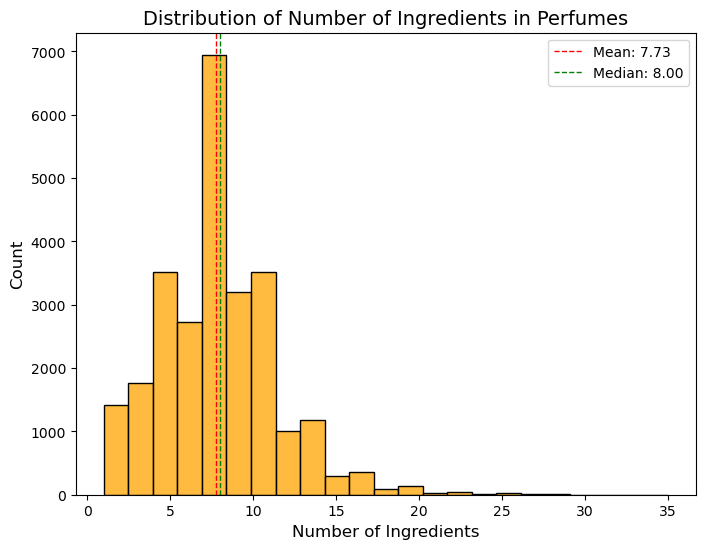

In [253]:
plt.figure(figsize=(8, 6))
sns.histplot(df_ingredients_mean['num_ingredients'], kde=False, bins=23, color='orange', edgecolor='black')

plt.axvline(mean_ingredients, color='red', linestyle='dashed', linewidth=1, label=f'Mean: {mean_ingredients:.2f}')
plt.axvline(median_ingredients, color='green', linestyle='dashed', linewidth=1, label=f'Median: {median_ingredients:.2f}')

plt.title('Distribution of Number of Ingredients in Perfumes', fontsize=14)
plt.xlabel('Number of Ingredients', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.legend()
plt.show()

#### Conclusion 3:
what is the mean number of ingredients used in perfumes?


In [254]:
print(mean_ingredients)

7.731068809605228


### 4. Which ingredients belong to which families?/Which one is the most common one?

correlation between ingredients and family

In [255]:
df_common_ingredients_family = df

4.1 make a column for each ingredient and group by family

In [256]:
df_ingredients_family = df[["ingredients", "family"]]

df_exploded = df_ingredients_family.explode('ingredients')

ingredient_matrix = pd.get_dummies(df_exploded, columns=['family'], prefix='', prefix_sep='').groupby('ingredients').sum()



**4.1 Visualization:** heatmap

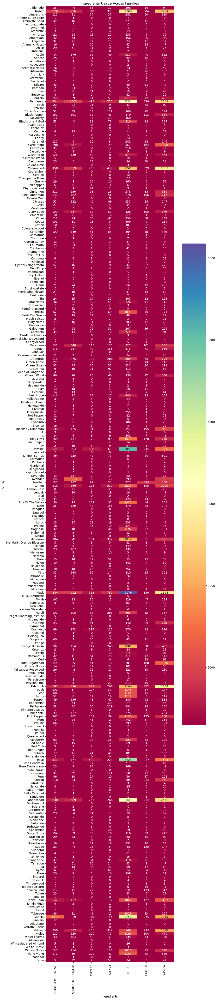

In [257]:
plt.figure(figsize=(10, 60))
sns.heatmap(ingredient_matrix, vmin=300, annot=True, cmap='Spectral', fmt='d')
plt.title('Ingredients Usage Across Families')
plt.xlabel('Ingredients')
plt.ylabel('Family')
plt.show()

show as a list and only show the most common ingredient per family

In [258]:
df_exploded = df_common_ingredients_family[["ingredients","family","subfamily"]].explode("ingredients")

ingredient_counts = (
    df_exploded.groupby(["family", "ingredients"])
    .size()
    .reset_index(name="count")
)

most_common_ingredients = (
    ingredient_counts.loc[ingredient_counts.groupby("family")["count"].idxmax()]
    .reset_index(drop=True)
)

print(most_common_ingredients)

ingredient_counts_subfamily = (
    df_exploded.groupby(["subfamily", "ingredients"])
    .size()
    .reset_index(name="count")
)

most_common_ingredients_subfamily = (
    ingredient_counts_subfamily.loc[ingredient_counts_subfamily.groupby("subfamily")["count"].idxmax()]
    .reset_index(drop=True)
)
print("")
print(most_common_ingredients_subfamily)

              family ingredients  count
0  AMBERY (ORIENTAL)     Vanilla   1410
1   AROMATIC FOUGERE    Lavender   1254
2             CHYPRE   Patchouli    844
3             CITRUS        Musk    782
4             FLORAL        Musk   6176
5            LEATHER     Leather    818
6              WOODY   Patchouli   2804

            subfamily   ingredients  count
0           ALDEHYDIC          Musk    253
1   AMBERY (ORIENTAL)       Vanilla   3554
2    AROMATIC FOUGERE      Lavender    573
3              CHYPRE      Bergamot     98
4              CITRUS      Bergamot   2645
5              FLORAL          Rose   1537
6              FRUITY          Musk   1748
7            GOURMAND       Vanilla    435
8               GREEN          Musk    610
9             LEATHER       Leather     73
10          MUSK SKIN          Musk    815
11              SPICY     Cedarwood    175
12            TOBACCO  Tobacco Leaf     66
13             WATERY          Musk    401
14              WOODY     Patchoul

#### Conclusion 4:
which ingredients belong to which (sub)families?/Which one is the most common one?

**Examples:**
  * Most common ingredient of family Ambery(oriental) is Vanilla
  * Most common ingredient of subfamily Spicy is Cedarwood

the heatmap is not the best visualization for searching the most common ingredient but with a heatmap you can see all of the ingredients which belong to a family.

### 5. Which families/subfamilies were popular in which years?

Frequency of families/subfamilies over the years (starting from 2000)

**5.1 Visualization:** heatmap of families over the years

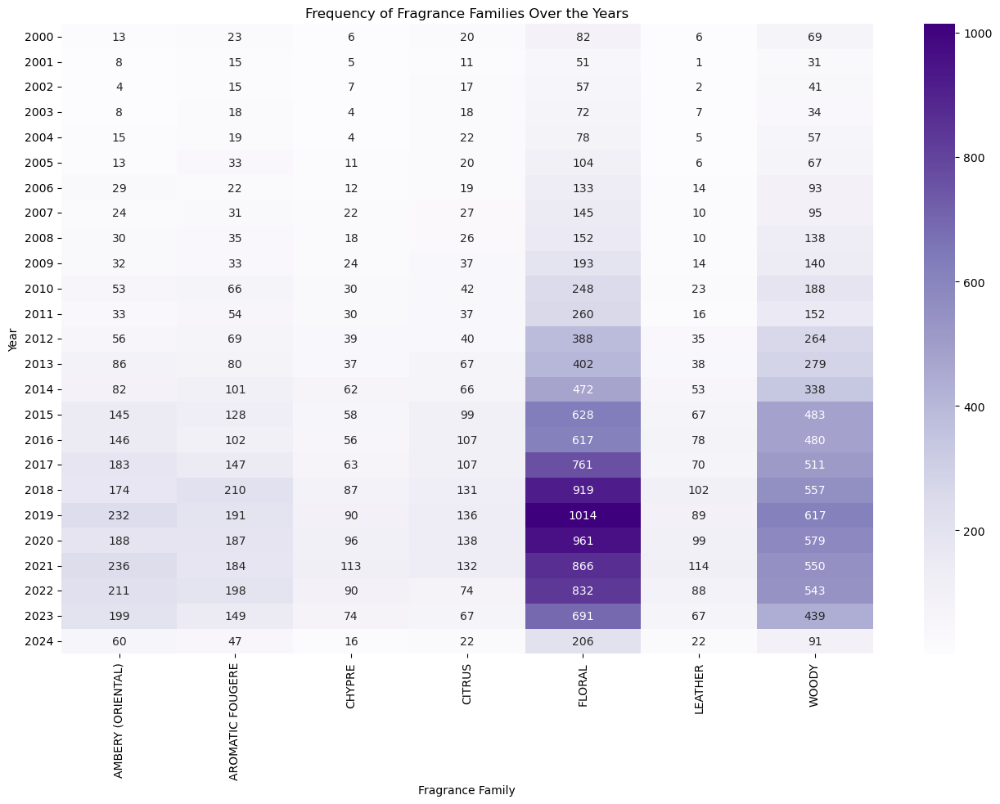

In [259]:
family_years = df.groupby(['years', 'family']).size().unstack(fill_value=0)

plt.figure(figsize=(16, 10))
sns.heatmap(family_years.loc[2000:], annot=True, fmt='d', cmap='Purples', cbar=True)
plt.title('Frequency of Fragrance Families Over the Years')
plt.ylabel('Year')
plt.xlabel('Fragrance Family')
plt.show()

**5.2 Visualization:** heatmap of subfamilies over the years

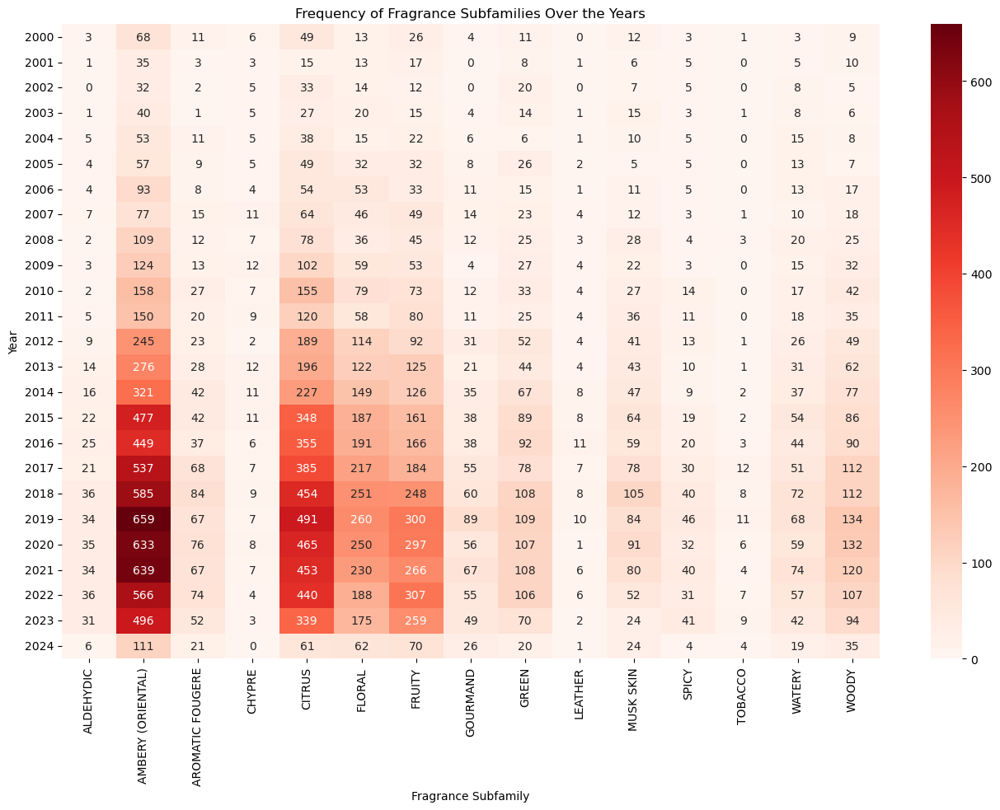

In [260]:
subfamily_years = df.groupby(['years', 'subfamily']).size().unstack(fill_value=0)

plt.figure(figsize=(16,10))
sns.heatmap(subfamily_years.loc[2000:], annot=True, fmt='d', cmap='Reds', cbar=True)
plt.title('Frequency of Fragrance Subfamilies Over the Years')
plt.ylabel('Year')
plt.xlabel('Fragrance Subfamily')
plt.show()

**5.3 Visualization:** heatmap of proportional division across perfume families starting from 2000

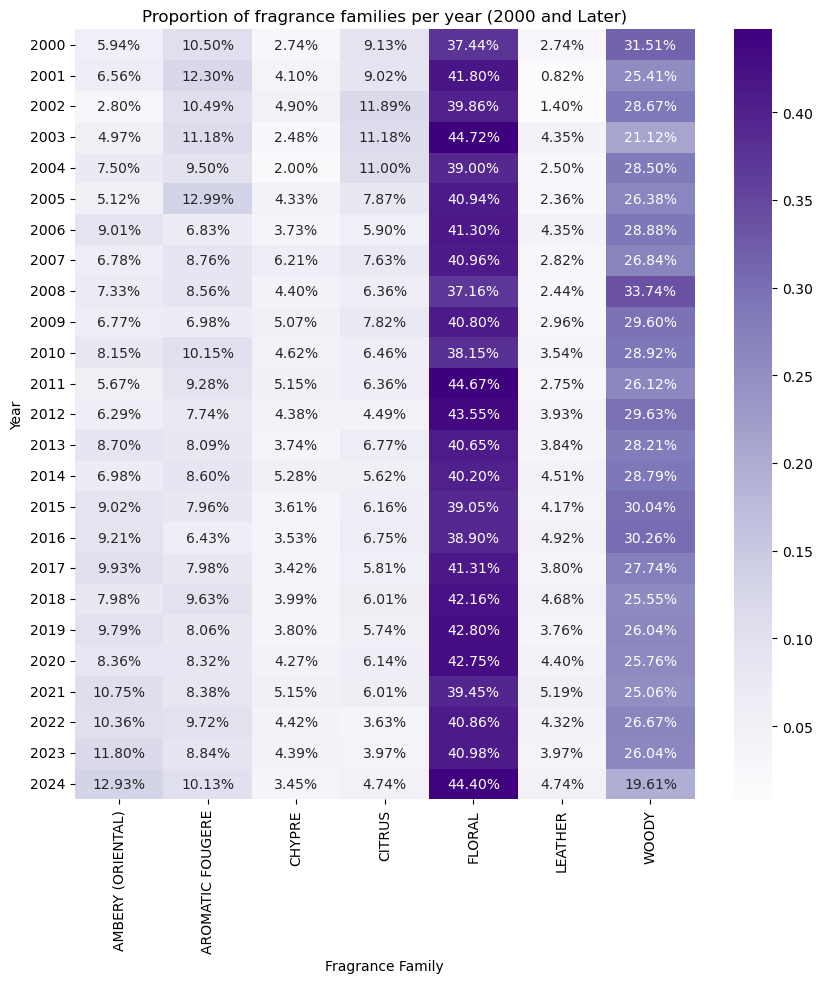

In [261]:
family_proportions = family_years.div(family_years.sum(axis=1), axis=0)

plt.figure(figsize=(10, 10))
sns.heatmap(
    family_proportions.loc[2000:],
    annot=True, fmt='.2%', cmap='Purples', cbar=True
)
plt.title('Proportion of fragrance families per year (2000 and Later)')
plt.ylabel('Year')
plt.xlabel('Fragrance Family')
plt.show()

**5.4 Visualization:** heatmap of proportional division across perfume subfamilies starting from 2000

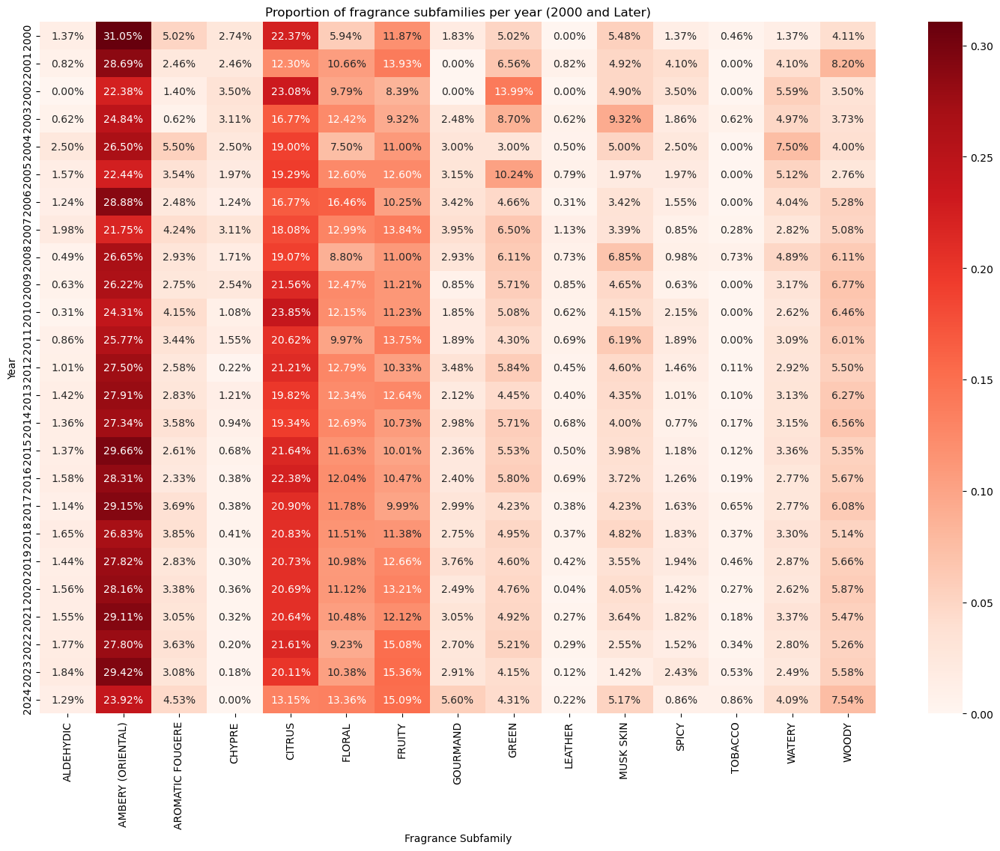

In [262]:
family_proportions = subfamily_years.div(subfamily_years.sum(axis=1), axis=0)

plt.figure(figsize=(18, 12))
sns.heatmap(
    family_proportions.loc[2000:],
    annot=True, fmt='.2%', cmap='Reds', cbar=True
)
plt.title('Proportion of fragrance subfamilies per year (2000 and Later)')
plt.ylabel('Year')
plt.xlabel('Fragrance Subfamily')
plt.show()

#### Conclusion 5:
which families/subfamilies were popular in which years?

* floral and woody were always quite popular as a family --> You can see that the ratio of Floral and woody as the family scent is almost the same throughout 2000-2024
* You can see from the proportional data that ambery(oriental) and citrus scents were always quite popular as a subfamily
* the next most popular subfamilies are floral and fruity


### 6. How do ingredients differ between male and female perfumes?

correlation between gender and ingredients


Male Scents

6.1 filter after male perfumes

In [263]:
male_perfums = df[df["gender"] == "Male"]

6.2 create a list of all the male ingredients and count them

In [264]:
all_male_ingredients = [
    ingredient for sublist in male_perfums["ingredients"]
                    for ingredient in sublist]

In [265]:
ingredient_counter_male = Counter(all_male_ingredients)

6.3 display the most common 10 as a dictionary

In [266]:
most_common_male_ingredient = ingredient_counter_male.most_common(10)
for ingredient, count in most_common_male_ingredient:
    print(f"{ingredient}: {count}")

Bergamot: 2432
Cedarwood: 2244
Patchouli: 2177
Musk: 2034
Amber: 1908
Lavender: 1770
Vetiver: 1703
Sandalwood: 1699
Cardamom: 1311
Lemon: 1219


**6.4 Visualization:** bar chart of top 10 male ingredients

C:\Users\Kathi Weber\AppData\Local\Temp\ipykernel_23112\1405795678.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




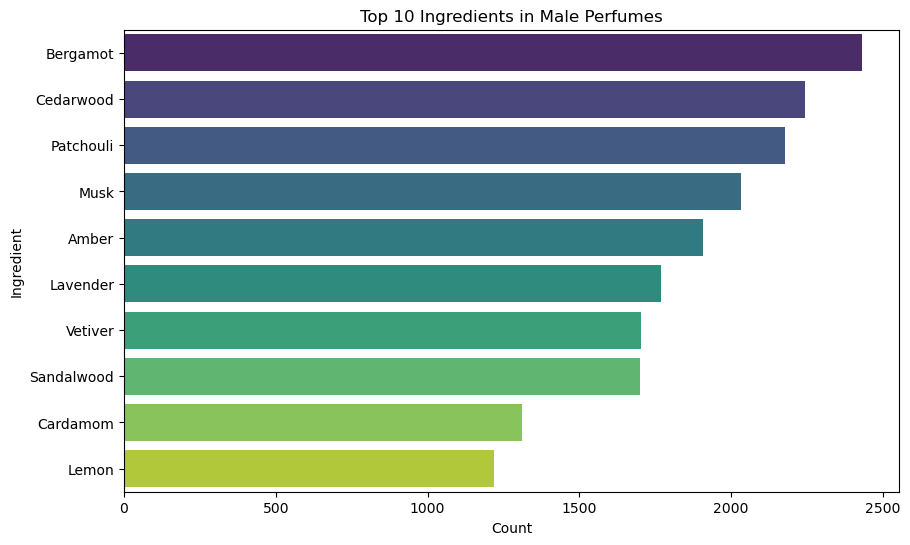

In [267]:
ingredients, counts = zip(*most_common_male_ingredient)

plt.figure(figsize=(10, 6))
sns.barplot(x=list(counts), y=list(ingredients), palette="viridis")
plt.title("Top 10 Ingredients in Male Perfumes")
plt.xlabel("Count")
plt.ylabel("Ingredient")
plt.show()

Female Scents

6.5 filter after female perfumes

In [268]:
female_perfums = df[df["gender"] == "Female"]

6.6 create a list of all the female ingredients and count them

In [269]:
all_female_ingredients = [
    ingredient for sublist in female_perfums["ingredients"]
                    for ingredient in sublist]

In [270]:
ingredient_counter_female = Counter(all_female_ingredients)

6.7 display the most common 10 as a dictionary

In [271]:
most_common_female_ingredient = ingredient_counter_female.most_common(10)
for ingredient_female, count_female in most_common_female_ingredient:
    print(f"{ingredient_female}: {count_female}")

Musk: 5330
Jasmine: 4658
Rose: 3838
Vanilla: 3811
Sandalwood: 3317
Bergamot: 3028
Amber: 2608
Patchouli: 2491
Cedarwood: 2094
Mandarin: 1994


**6.8 Visualization:** bar chart of top 10 female ingredients
Female Scents

C:\Users\Kathi Weber\AppData\Local\Temp\ipykernel_23112\3072274716.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




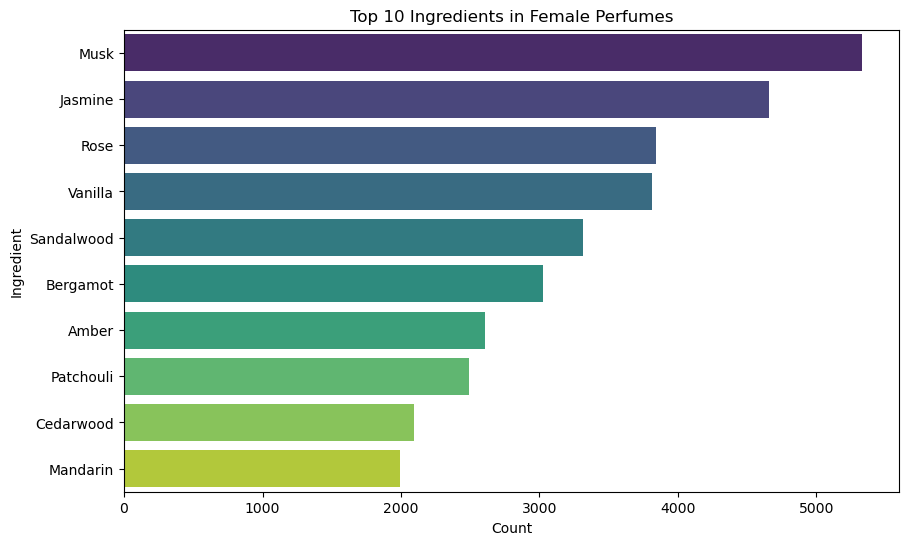

In [272]:
ingredients, counts = zip(*most_common_female_ingredient)

plt.figure(figsize=(10, 6))
sns.barplot(x=list(counts), y=list(ingredients), palette="viridis")
plt.title("Top 10 Ingredients in Female Perfumes")
plt.xlabel("Count")
plt.ylabel("Ingredient")
plt.show()

6.9 Analyze which ingredients are unique for men and women and which are used for both genders

create a set of all the female ingredients and unionize it with the male one

In [273]:
all_ingredients = set(ingredient_counter_female.keys()).union(set(ingredient_counter_male.keys()))

create a Dataframe which lists all male and female ingredients similar to a dictionary

In [274]:
aligned_counts = pd.DataFrame({
    "ingredient": list(all_ingredients),
    "male": [ingredient_counter_male.get(ingredient, 0) for ingredient in all_ingredients],
    "female": [ingredient_counter_female.get(ingredient, 0) for ingredient in all_ingredients],
})

see if there is a difference between male and female ingredients (which ones are common and which are unique to each gender)

In [275]:
aligned_counts['common'] = (aligned_counts['male'] > 0) & (aligned_counts['female'] > 0)
aligned_counts['unique_to_male'] = (aligned_counts['male'] > 0) & (aligned_counts['female'] == 0)
aligned_counts['unique_to_female'] = (aligned_counts['female'] > 0) & (aligned_counts['male'] == 0)

convert them to lists and print them

In [276]:
common_ingredients = aligned_counts[aligned_counts['common']]['ingredient'].tolist()
unique_to_male = aligned_counts[aligned_counts['unique_to_male']]['ingredient'].tolist()
unique_to_female = aligned_counts[aligned_counts['unique_to_female']]['ingredient'].tolist()

print("Common Ingredients:", common_ingredients)
print("Unique to Male:", unique_to_male)
print("Unique to Female:", unique_to_female)

Common Ingredients: ['Lime', 'Dew Drop', 'Coffee', 'Fresh Cut Grass', 'Cotton Candy', 'Tobacco Leaf', 'Heliotrope', 'Iris / Orris', 'Passion Fruit', 'Clementine', 'Clove', 'Cashmere Wood', 'Palisander Rosewood', 'Vetiver', 'Ambrofix', 'Raspberry', 'Spearmint', 'Cardamom', 'Guarana', 'Bay', 'Elemi', 'Ambroxan', 'Cinnamon', 'Violet', 'Yuzu', 'Iso E Super', 'Oakmoss', 'Benzoin', 'Spicy Notes', 'Aquozone', 'Caramel', 'Castoreum', 'Mate', 'Ginger', 'Salty Amber', 'Georgywood', 'Lavender', 'Cosmone', 'Dry Amber', 'Green Notes', 'Rosemary', 'Marjoram', 'Sea Water', 'Balsam', 'Neroli', 'Nirvanolide', 'Clary Sage', 'Tuberose', 'Javanol', 'Red Apple', 'Vanillin', 'Animalic Notes', 'Cocoa', 'Pineapple', 'Orchid', 'Fresh Spices', 'Heliotropine', 'Suede', 'Kephalis', 'Grapefruit', 'Salty Caramel', 'Candy', 'Maltol', 'Rose Centifolia', 'Night Blooming Jasmine', 'Hedione', 'Musk Ambrette', 'Tobacco Accord', 'Peach', 'Caviar Lime', 'Tiare', 'Red Ginger', 'Floralozone', 'Yodanol', 'Lavandin', 'Mahonial

#### Conclusion 6:
which ingredients are used in male perfumes vs. which ones are used in female perfumes?

**Top 3 used ingredients:**

**male perfumes:** Bergamot, Cedarwood, Patchouli

**female perfumes:** Musk, Jasmine, Rose

**Uniquely used ingredients:**

**male:** Calypsone, Sclarene, Timberol, Kingwood, Oceanol, Melozone, Vulcanolide, Safraleine, Presantone H, Suederal, Antillone, Creamytone, Timberwood, Ambrinol, Citrata Mint

**female:** Prunella, Mugane, Cologne Accord, Sorbettolide, Kharismal, Transluzone, Champagne Rosé, Queenwood, Cedramber, Nympheal, 'Globalide, Starfleur, Hellabore Flower, Crinum Lily, Gardenia Leaves, Arum Lily, Muscenone, Timbersilk, Paradisamide, Edenolide, Lilial, Limequat, Kyphi Accord, Lisylang, Romandolide, Santamanol, Tonalide, Cyclosal, Sweet Pea, Nerium Oleander, Nebulone

### 7. How is the distribution of the number of ingredients by release year?

take the created DataFrame which includes num_ingredients

In [277]:
df_distribution_ingredients_years = df_ingredients_mean 

**Visualization:** box-plot of the distribution of ingredients by release year

In [278]:
df_distribution_ingredients_years["num_ingredients"].loc

fig = px.box(
    df_distribution_ingredients_years,
    x='years',
    y='num_ingredients',
    color='years',
    hover_data=['name_perfume', 'brand', 'num_ingredients'],
    title="Interactive Boxplot: Number of Ingredients by Years",
    labels={'num_ingredients': 'Number of Ingredients', 'years': 'Release Year'}
)

# Update layout for better readability
fig.update_layout(
    xaxis=dict(range=[1950, max(df_distribution_ingredients_years['years'])]),
    xaxis_title="Release Years",
    yaxis_title="Number of Ingredients",
    template="plotly_white"
)

# Show the plot
fig.show()

#### Conclusion 7:
How is the distribution of the number of ingredients by release year?

**Example:**

in the year 1990
* max. amount of ingredients is 20
* min. amount of ingredients is 6
* median is 11 ingredients



### 8. Which words are mostly used in perfume descriptions? (difference between male and female descriptions?)

8.1 set custom filler words and get the imported english stopwords

In [279]:
custom_filler_words = {"fragrance", "scent", "notes", "perfume", "like", "male","female","women", "men","man","woman", "de"}
stop_words = set(stopwords.words('english')) | custom_filler_words


8.2 create function to clean the sentences of the description

In [280]:
def clean_and_tokenize(text):
    if not isinstance(text, str):
        return ""

    text = text.lower()
    text = re.sub(r'[^\w\s]', '', text)
    words = text.split()
    words = [word for word in words if word not in stop_words]
    return words

8.3 create function to get the most common words

apply clean_and_tokenize function to given dataframe and explode the words  -->  then count them and find the most common words

In [281]:
def get_most_common_words(dataframe, count):
  words = dataframe.apply(clean_and_tokenize).explode()
  word_counts = Counter(words)
  most_common_words = word_counts.most_common(count)

  print("Most common words and their frequencies:")
  for word, count in most_common_words:
      print(f"{word}: {count}")


get words of all descriptions

In [282]:
df_all = df_description["description"]
get_most_common_words(df_all, 5)

Most common words and their frequencies:
fresh: 2421
sensual: 2359
inspired: 2140
love: 2018
floral: 1948


only female scents

In [283]:
df_female = df_description[df_description["gender"] == "Female"].description
get_most_common_words(df_female, 5)

Most common words and their frequencies:
floral: 1188
sensual: 1094
love: 1085
fresh: 920
flowers: 782


only male scents

In [284]:
df_female = df_description[df_description["gender"] == "Male"].description
get_most_common_words(df_female, 5)

Most common words and their frequencies:
fresh: 635
masculine: 620
modern: 500
life: 479
sensual: 441


only unisex scents

In [285]:
df_female = df_description[df_description["gender"] == "Unisex"].description
get_most_common_words(df_female, 5)

Most common words and their frequencies:
inspired: 1008
fresh: 866
sensual: 824
warm: 764
one: 734


### 9. Which brands released their perfumes in which years?


In [286]:
df.columns

Index(['brand', 'name_perfume', 'family', 'subfamily', 'fragrances',
       'ingredients', 'origin', 'gender', 'years', 'description', 'image_name',
       'num_ingredients'],
      dtype='object')

**Visualize:** scatter plot

In [287]:
fig = px.scatter(
    df,
    x='years',
    y='brand',
    color='brand',
    hover_data=['name_perfume', 'brand'], 
    title="Scatter Plot: Perfume Releases by Year and Gender",
    labels={'years': 'Release Year', 'brand': 'Brand'}
)

fig.update_layout(
    height=1500,
    width=1200,
    xaxis_title="Release Year",
    yaxis_title="",
    template="plotly_white",
    yaxis=dict(scaleanchor=None, range=None)
    )

fig.show()

#### Conclusion 9:
 Which brands released their perfumes in which years?

 **Example**

* in the year 1828 there were only perfumes released from the brand Santa Maria Novella --> Interesting that there are still perfumes found by this brand in 2023
* Some recent brands with only one perfume so far are: Off-White, Head, Kazo, Brand no more or Mavemade

### 10. Which countries are the origins of which fragrance families?

correlation between origin and families

In [288]:
df_origin_fam = df[["origin", "family", "subfamily"]]


Encode categorical variables

In [289]:
label_encoder = LabelEncoder()
df_origin_fam['family_encoded'] = label_encoder.fit_transform(df_origin_fam['family'])
df_origin_fam['origin_encoded'] = label_encoder.fit_transform(df_origin_fam['origin'])

C:\Users\Kathi Weber\AppData\Local\Temp\ipykernel_23112\714998895.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Kathi Weber\AppData\Local\Temp\ipykernel_23112\714998895.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Select the relevant columns for visualization

In [290]:
scatter_data = df_origin_fam[['family_encoded', 'origin_encoded']]

Version 1: more complicated one

**Visualization:** scatter matrix

In [291]:
fig = px.scatter_matrix(
    scatter_data,
    dimensions=['family_encoded', 'origin_encoded'],
    labels={'family_encoded': 'Family', 'origin_encoded': 'Origin'},
    title="Scatter Matrix of Family and Origin",
    color=df_origin_fam['family'],
)

fig.update_traces(diagonal_visible=True)
fig.update_layout(width=900, height=900)
fig.show()

Version 2: easier one

In [292]:
px.histogram(df_origin_fam, x="origin", color="family")

In [293]:
px.histogram(df_origin_fam, x="origin", color="subfamily")

#### Conclusion 10:
which countries/continents are the origins of which fragrance families?
* you can see that France produces the most perfumes followed by USA and Italy
* the most produced families are Floral and Woody
* the most produces subfamilies are Ambery (Oriental) and Citrus

## Data Modelling

using **Unsupervised Learning**:
* PCA for data dimensionality reduction
* k-NN to find nearest neighbors of a given perfume
* kmeans for creating Clusters
* pyplot for visuailzation

check if the wanted perfume is in the dataframe

In [294]:
perfumes_starting_with = df[df['name_perfume'].str.startswith('Sauvage', na=False)]

print(perfumes_starting_with)

      brand                          name_perfume            family  \
176    Dior  Sauvage Elixir Baccarat Edition 2023  AROMATIC FOUGERE   
10744  Dior                        Sauvage Parfum             WOODY   
16174  Dior                        Sauvage Elixir  AROMATIC FOUGERE   
16524  Dior               Sauvage Very Cool Spray  AROMATIC FOUGERE   
21736  Dior               Sauvage Eau De Toilette  AROMATIC FOUGERE   
23174  Dior                 Sauvage Eau De Parfum  AROMATIC FOUGERE   

               subfamily                       fragrances  \
176                SPICY     Aromatic Fougère Crisp Spicy   
10744  AMBERY (ORIENTAL)              Woody Amber Fresher   
16174              SPICY   Aromatic Fougère Fresher Spicy   
16524             CITRUS  Aromatic Fougère Fresher Citrus   
21736             CITRUS  Aromatic Fougère Fresher Citrus   
23174             CITRUS  Aromatic Fougère Fresher Citrus   

                                             ingredients  origin gender  \

1. prepare the Data

1.2 start with a reduced DataFrame

In [295]:
df_copy = df[["ingredients", "name_perfume", "family","subfamily"]]

1.3 make a list of all the perfume names in the dataframe

In [296]:
perfume_names = df["name_perfume"].tolist()

1.4 split ingredients column into columns for all the different ingredients

In [297]:
mlb = MultiLabelBinarizer()
ingredient_encoded = mlb.fit_transform(df_copy["ingredients"])
ingredient_columns = mlb.classes_


1.5 rejoin the original dataframe with the new one and delete the ingredients column

In [298]:
ingredient_df = pd.DataFrame(ingredient_encoded, columns=ingredient_columns)
df_copy = pd.concat([df_copy, ingredient_df], axis=1)
df_copy.drop(columns=["ingredients"], inplace=True)

1.6 adjusts the data so that each feature (column) has an average value of 0 and all values are measured on the same scale, making them easier to compare.

In [299]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(ingredient_df)
print(scaled_data)

[[-0.14744482 -0.63600627 -0.19446197 ... -0.28326902 -0.0087176
  -0.09450923]
 [-0.14744482 -0.63600627 -0.19446197 ... -0.28326902 -0.0087176
  -0.09450923]
 [-0.14744482 -0.63600627 -0.19446197 ...  3.53021304 -0.0087176
  -0.09450923]
 ...
 [-0.14744482 -0.63600627 -0.19446197 ... -0.28326902 -0.0087176
  -0.09450923]
 [-0.14744482 -0.63600627 -0.19446197 ... -0.28326902 -0.0087176
  -0.09450923]
 [-0.14744482 -0.63600627 -0.19446197 ... -0.28326902 -0.0087176
  -0.09450923]]


2. Dimensionality reduction

reducing the dimensionionality of the data to two components (the most important patterns)

In [300]:
pca = PCA(n_components=2)  # Adjust number of components as needed
reduced_data = pca.fit_transform(scaled_data)

3. calculating the nearest neighbors

calculating the nearest neighbors of a point using euclidean distance


In [301]:
knn = NearestNeighbors(n_neighbors=3, metric='euclidean')
knn.fit(reduced_data)

NearestNeighbors(metric='euclidean', n_neighbors=3)

4. calculate for one specific perfume

4.1 specify perfume name, find index and reduced version of it

In [302]:
query_perfume_name = "Sauvage Elixir"
query_index = perfume_names.index(query_perfume_name)
query_perfume = reduced_data[query_index].reshape(1, -1)

4.2 find nearest neighbor of this specific perfume (get the distance and the index)

In [303]:
distances, indices = knn.kneighbors(query_perfume)

4.3 get the names of similar smelling perfumes to the queried one

In [304]:
similar_perfumes = [perfume_names[i] for i in indices[0]]
print("Similar perfumes:", similar_perfumes)
print("Distances:", distances[0])

Similar perfumes: ['Sauvage Elixir Baccarat Edition 2023', 'Sauvage Elixir', 'Give Me A Chance']
Distances: [0.         0.         0.06991014]


5. **Visualization:** scatter plot with clusters

5.1 cluster the data with kmeans

In [305]:
kmeans = KMeans(n_clusters=20, random_state=42) 
cluster_labels = kmeans.fit_predict(reduced_data)

5.2 scatter plot with clusters

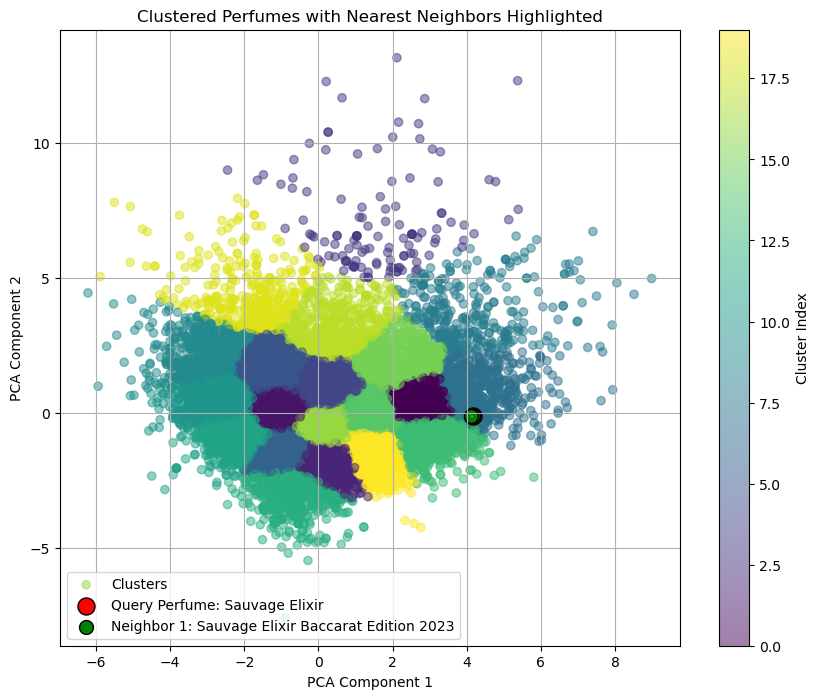

In [306]:
# Scatter plot with clusters
plt.figure(figsize=(10, 8))
scatter = plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5, label='Clusters')
plt.colorbar(scatter, label='Cluster Index')

# Highlight query and neighbors
plt.scatter(query_perfume[0, 0], query_perfume[0, 1], c='red', label=f'Query Perfume: {query_perfume_name}', s=150, edgecolor='black')
for i, index in enumerate(indices[0]):
    neighbor_coords = reduced_data[index]
    plt.scatter(neighbor_coords[0], neighbor_coords[1], c='green', label=f'Neighbor {i + 1}: {perfume_names[index]}' if i == 0 else None, s=100, edgecolor='black')
    plt.plot([query_perfume[0, 0], neighbor_coords[0]], [query_perfume[0, 1], neighbor_coords[1]], c='gray', linestyle='--')

# Add annotations
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('Clustered Perfumes with Nearest Neighbors Highlighted')
plt.legend()
plt.grid(True)
plt.show()


**6. Visualize:** scatter plot with plotly

6.1 Prepare DataFrame for Plotly

In [307]:
plot_data = pd.DataFrame(reduced_data, columns=['PCA1', 'PCA2'])
plot_data['Perfume'] = perfume_names
plot_data['Cluster'] = cluster_labels

6.2 Add Query Perfume and Neighbors

In [308]:
plot_data.loc[query_index, 'Type'] = 'Query'
plot_data.loc[indices[0], 'Type'] = 'Neighbor'
plot_data['Type'].fillna('Other', inplace=True)

C:\Users\Kathi Weber\AppData\Local\Temp\ipykernel_23112\695078064.py:3: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





6.3 create scatter plot and show it 

In [309]:
fig = px.scatter(
    plot_data,
    x='PCA1',
    y='PCA2',
    color='Type',
    hover_data=['Perfume'],
    title='Perfume Similarity Visualization'
)
fig.update_traces(marker=dict(size=10))
fig.show()
